# Annotations using clustering for cells for tonsil_s0

In [1]:
slide_id = "tonsil_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_tonsil_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 41995, 31469), (3, 20998, 15735)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (1349620, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (1349620, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (1349620, 377)
      └── 'table_nuclei': AnnData (1349620, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 1349620 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,92,0,0,0,0,92,42.040470,27.725939,cell_labels
1,aaaaaaab-1,46,0,0,0,0,46,31.925470,8.037813,cell_labels
2,aaaaaaac-1,48,0,0,0,0,48,37.208751,19.823594,cell_labels
3,aaaaaaad-1,62,0,0,0,0,62,56.309846,13.908126,cell_labels
4,aaaaaaae-1,60,0,0,0,0,60,42.040470,13.862969,cell_labels
...,...,...,...,...,...,...,...,...,...,...
1349615,aabejhop-1,213,0,0,0,0,213,278.930166,21.991095,cell_labels
1349616,aabejhpa-1,178,0,0,0,0,178,76.178597,38.744064,cell_labels
1349617,aabejhpb-1,251,0,0,0,0,251,235.309227,54.819689,cell_labels
1349618,aabejhpc-1,13,0,0,0,0,13,853.904718,8.624844,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 1277643 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,24.948997,Tonsillar crypt,70,0,8,7,8,T,Proliferating_Treg,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,7.315320,Naive CD8 T,25,4,2,9,10,Endothelial,Endothelial,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,18.265802,Naive CD8 T,35,0,1,0,1,T,T,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,12.598752,cDC2,22,1,7,0,7,Plasma,Plasma,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,12.621283,Granulocyte,20,4,2,9,10,Endothelial,Endothelial,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aabejhoo-1,nucleus_boundaries,morpho,aabejhoo-1,40.686362,Tonsillar crypt,115,2,3,1,3,Epithelial,Epithelial,normal_cell
aabejhop-1,nucleus_boundaries,morpho,aabejhop-1,20.522395,Pre-B cell,89,0,1,7,1,T,T,normal_cell
aabejhpa-1,nucleus_boundaries,morpho,aabejhpa-1,36.082324,Macrophage,113,2,3,4,3,Epithelial,Epithelial,normal_cell
aabejhpb-1,nucleus_boundaries,morpho,aabejhpb-1,51.502550,Macrophage,127,2,3,4,3,Epithelial,Epithelial,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.010218,0.236543
ACE2,0.056467,0.554798
ACKR1,0.127388,0.841053
ACTA2,0.391491,1.444428
ACTG2,1.594355,2.555430
...,...,...
UnassignedCodeword_0499,0.002778,0.125398
VCAN,0.158372,0.935281
VSIG4,0.078909,0.657008
VWA5A,0.206566,1.047216


## 2. Preprocessing

<Axes: >

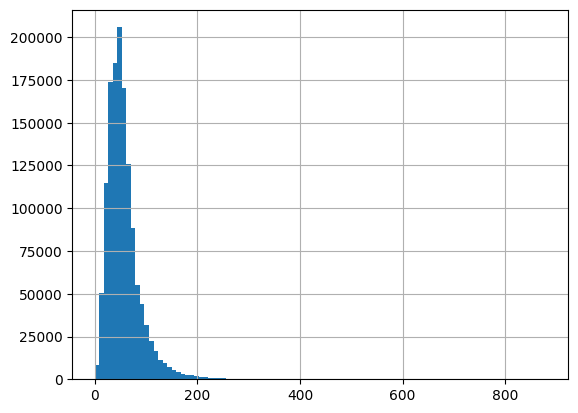

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

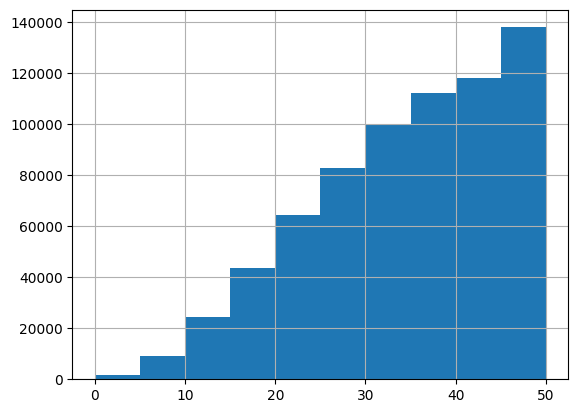

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 78607
Percentage of cells with less than 20 transcripts: 5.82%
-----
Number of cells with less than 15 transcripts: 35082
Percentage of cells with less than 15 transcripts: 2.6%
-----
Number of cells with less than 10 transcripts: 10835
Percentage of cells with less than 10 transcripts: 0.8%
-----
Number total of cells: 1349620


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

1335347


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


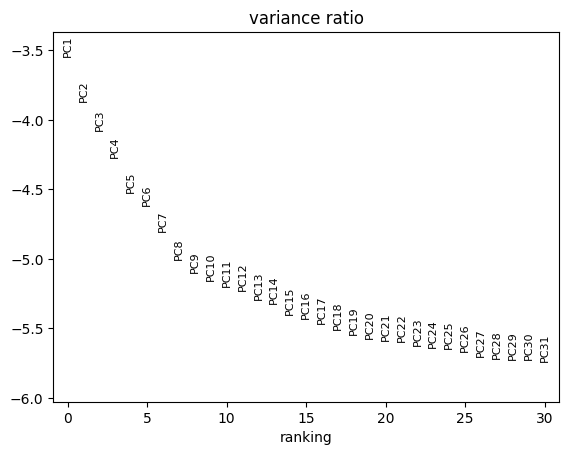

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 1335347 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3425/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


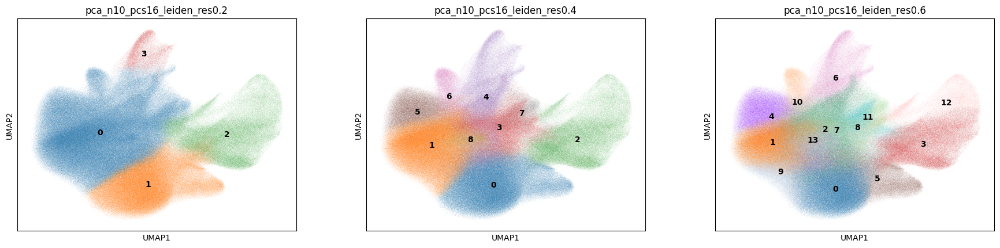

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['13', '6', '2', '4', '10', ..., '0', '9', '5', '12', '3']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'

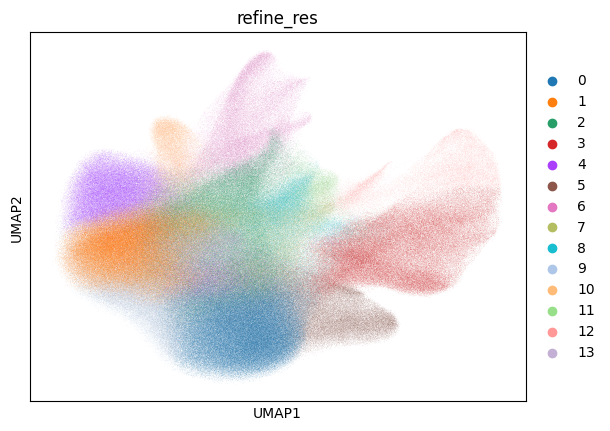

In [48]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'])

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

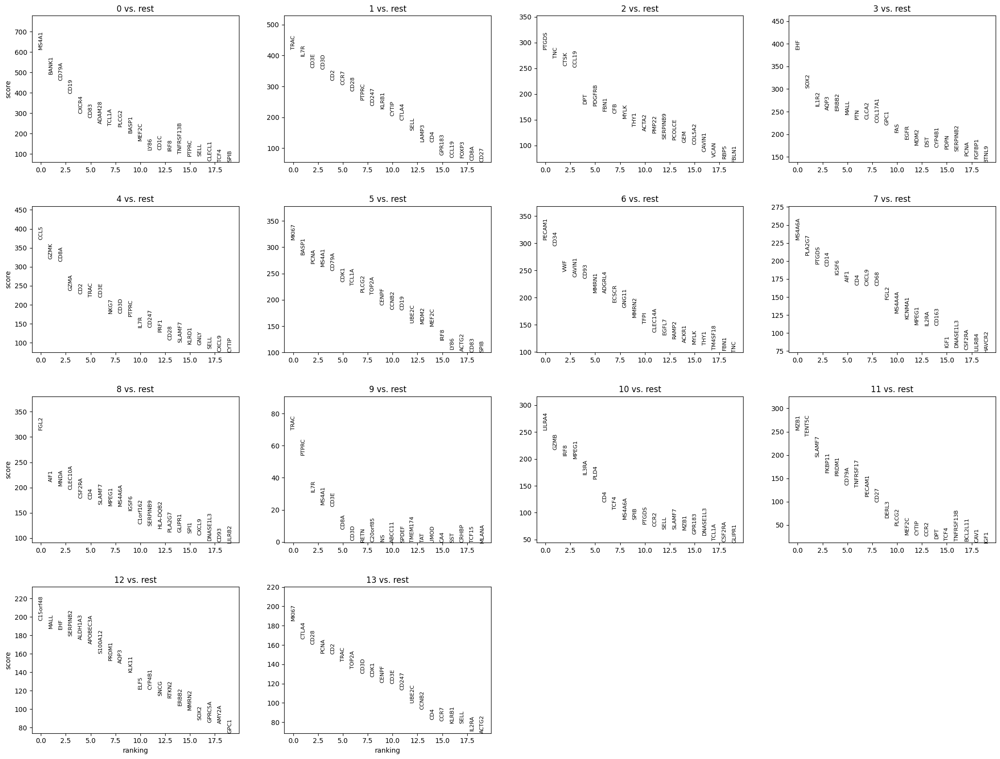

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,90.1
1,T,T,normal_cell,3.6
2,DC,Follicular_DC,normal_cell,3.0
3,NA,NA,NA,1.4
4,B,Proliferating_B,normal_cell,0.5


In [33]:
top_ranked_genes[cluster_id]

0     MS4A1
1     BANK1
2     CD79A
3      CD19
4     CXCR4
5      CD83
6    ADAM28
Name: 0, dtype: object

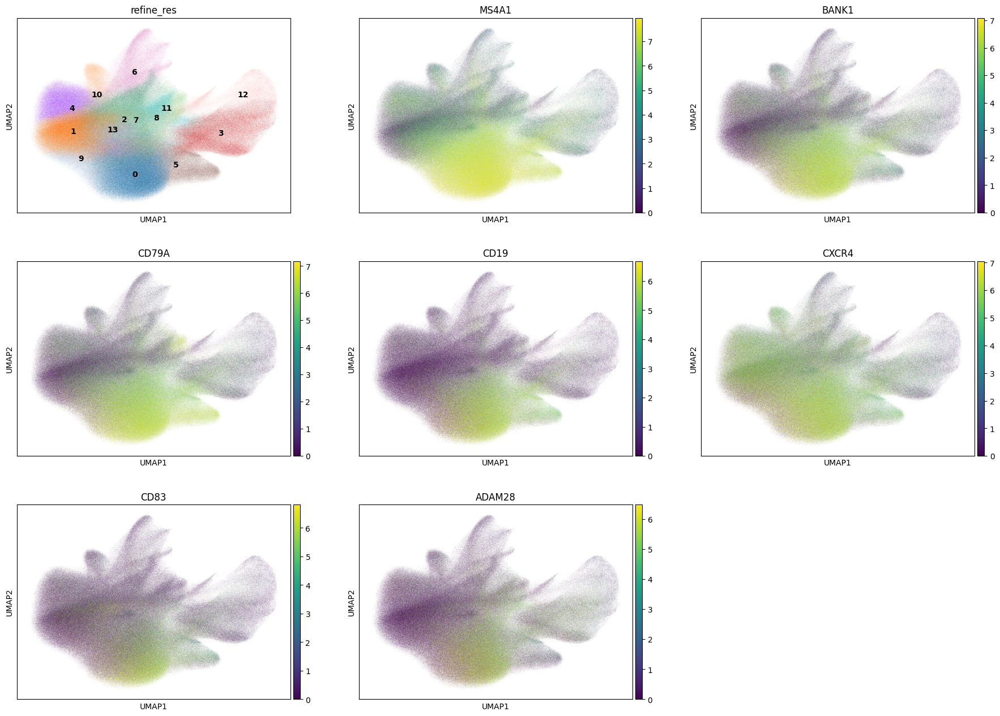

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 233043
Percentage of cells in cluster 0: 17.5


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,92.4
1,NA,NA,NA,2.1
2,B,B,normal_cell,1.6
3,DC,Follicular_DC,normal_cell,1.3
4,T,T_CD8,normal_cell,1.2


In [39]:
top_ranked_genes[cluster_id]

0    TRAC
1    IL7R
2    CD3E
3    CD3D
4     CD2
5    CCR7
6    CD28
Name: 1, dtype: object

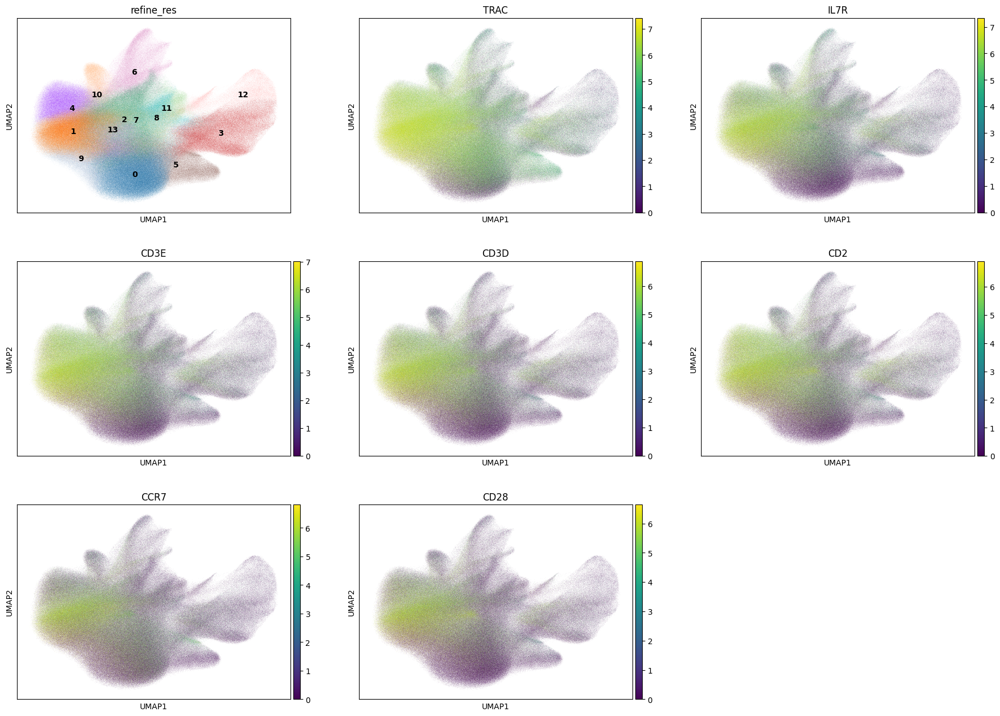

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 195908
Percentage of cells in cluster 1: 14.7


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,DC,Follicular_DC,normal_cell,48.3
1,T,T,normal_cell,21.4
2,B,B,normal_cell,15.4
3,NA,NA,NA,6.3
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.2


In [45]:
top_ranked_genes[cluster_id]

0     PTGDS
1       TNC
2      CTSK
3     CCL19
4       DPT
5    PDGFRB
6      FBN1
Name: 2, dtype: object

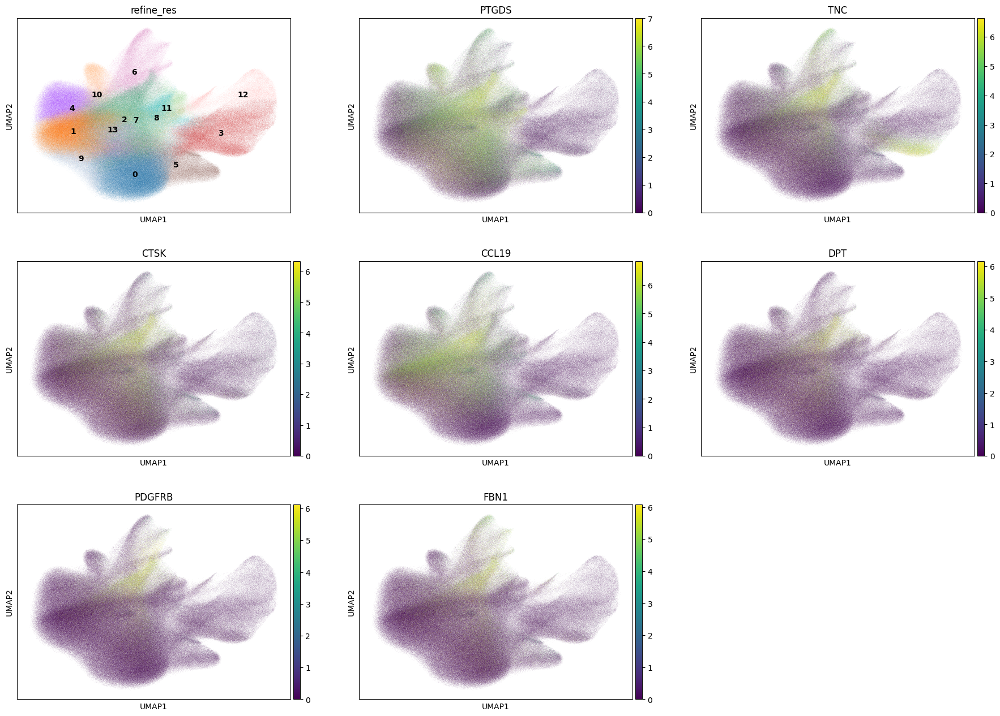

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 151308
Percentage of cells in cluster 2: 11.3


In [49]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast/Myofibroblast'

### 5.4. Cluster 3

In [50]:
cluster_id = '3'

In [51]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Epithelial,normal_cell,62.7
1,B,B,normal_cell,17.8
2,T,T,normal_cell,8.4
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.4
4,T,T_CD8,normal_cell,2.7


In [52]:
top_ranked_genes[cluster_id]

0      EHF
1     SOX2
2    IL1R2
3     AQP3
4    ERBB2
5     MALL
6      PTN
Name: 3, dtype: object

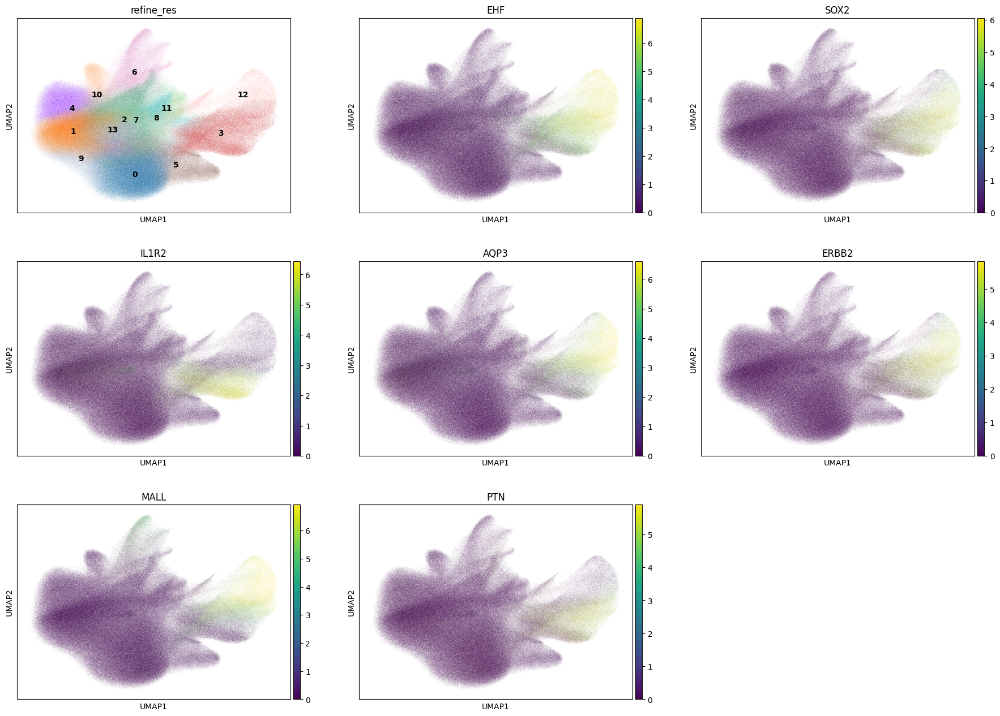

In [53]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [54]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 141086
Percentage of cells in cluster 3: 10.6


In [55]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.5. Cluster 4

In [56]:
cluster_id = '4'

In [57]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T_CD8,normal_cell,53.8
1,T,T,normal_cell,31.4
2,B,B,normal_cell,9.0
3,DC,Follicular_DC,normal_cell,1.6
4,T,Proliferating_Treg,normal_cell,1.5


In [58]:
top_ranked_genes[cluster_id]

0    CCL5
1    GZMK
2    CD8A
3    GZMA
4     CD2
5    TRAC
6    CD3E
Name: 4, dtype: object

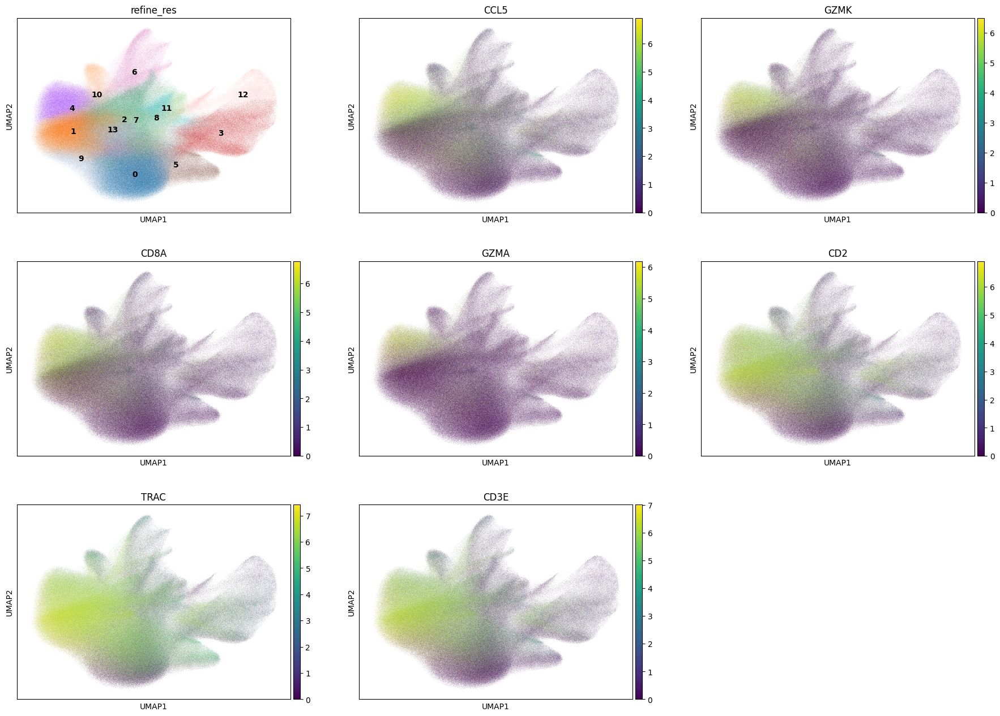

In [59]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 128751
Percentage of cells in cluster 4: 9.6


In [61]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.6. Cluster 5

In [62]:
cluster_id = '5'

In [63]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,Proliferating_B,normal_cell,47.6
1,B,B,normal_cell,36.0
2,T,T,normal_cell,7.8
3,T,Proliferating_Treg,normal_cell,3.2
4,DC,Follicular_DC,normal_cell,2.1


In [64]:
top_ranked_genes[cluster_id]

0    MKI67
1    BASP1
2     PCNA
3    MS4A1
4    CD79A
5     CDK1
6    TCL1A
Name: 5, dtype: object

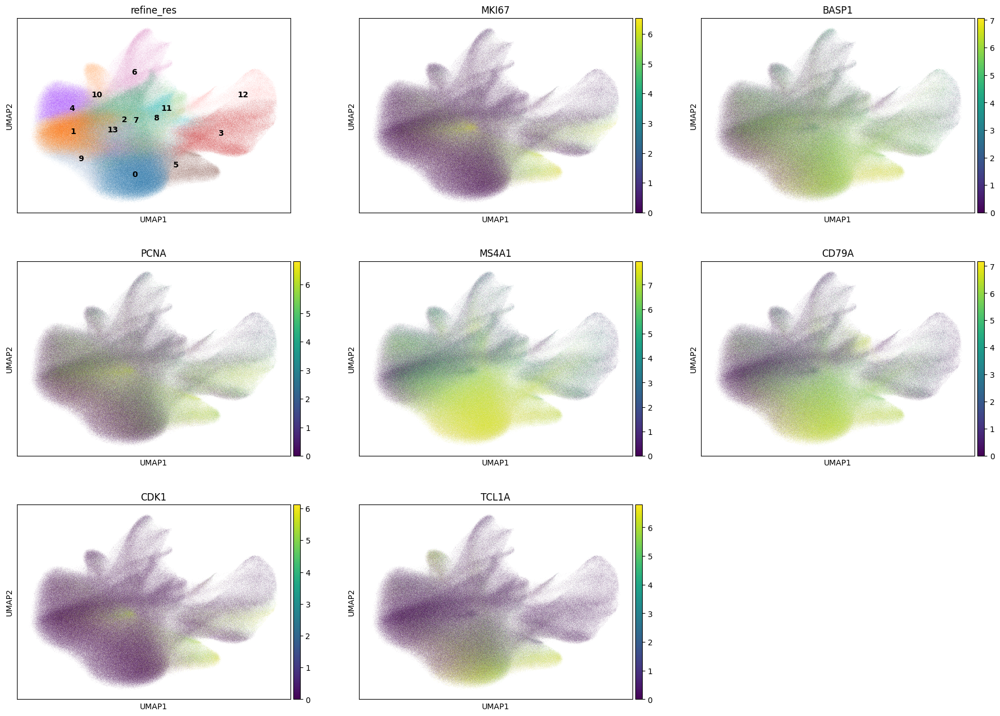

In [65]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 82073
Percentage of cells in cluster 5: 6.1


In [67]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_B'

### 5.7. Cluster 6

In [68]:
cluster_id = '6'

In [69]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,42.2
1,DC,Follicular_DC,normal_cell,23.8
2,T,T,normal_cell,11.8
3,NA,NA,NA,8.2
4,B,B,normal_cell,5.3


In [70]:
top_ranked_genes[cluster_id]

0    PECAM1
1      CD34
2       VWF
3    CAVIN1
4      CD93
5     MMRN1
6    ADGRL4
Name: 6, dtype: object

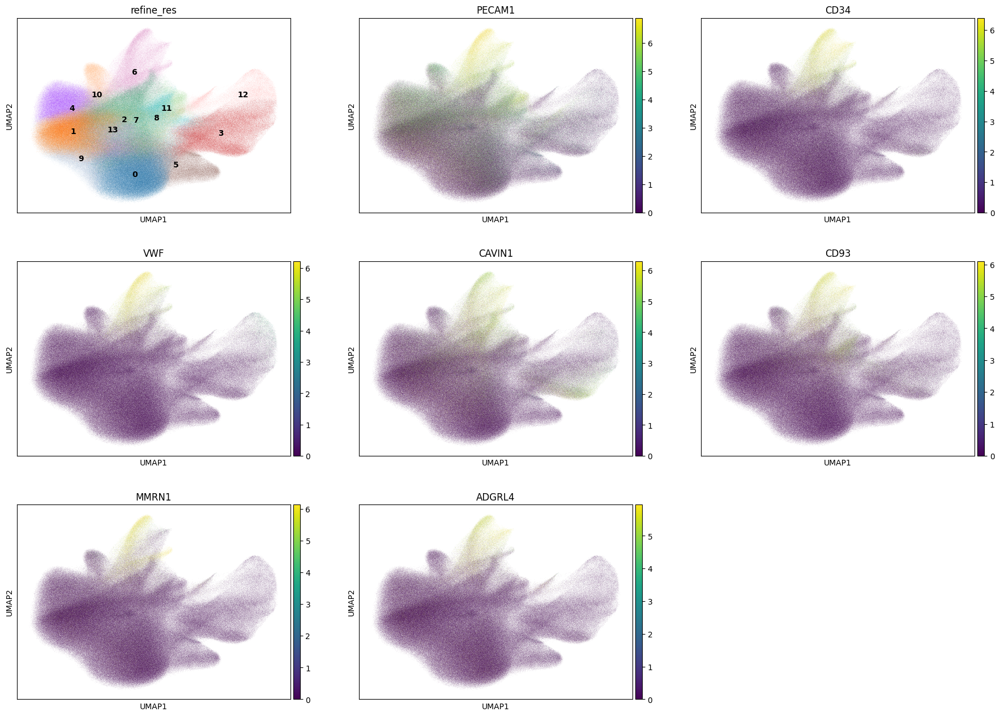

In [71]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 74494
Percentage of cells in cluster 6: 5.6


In [73]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.8. Cluster 7

In [74]:
cluster_id = '7'

In [75]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,41.0
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,29.3
2,B,B,normal_cell,16.1
3,T,T_CD8,normal_cell,5.2
4,NA,NA,NA,3.6


In [76]:
top_ranked_genes[cluster_id]

0    MS4A6A
1    PLA2G7
2     PTGDS
3      CD14
4     IGSF6
5      AIF1
6       CD4
Name: 7, dtype: object

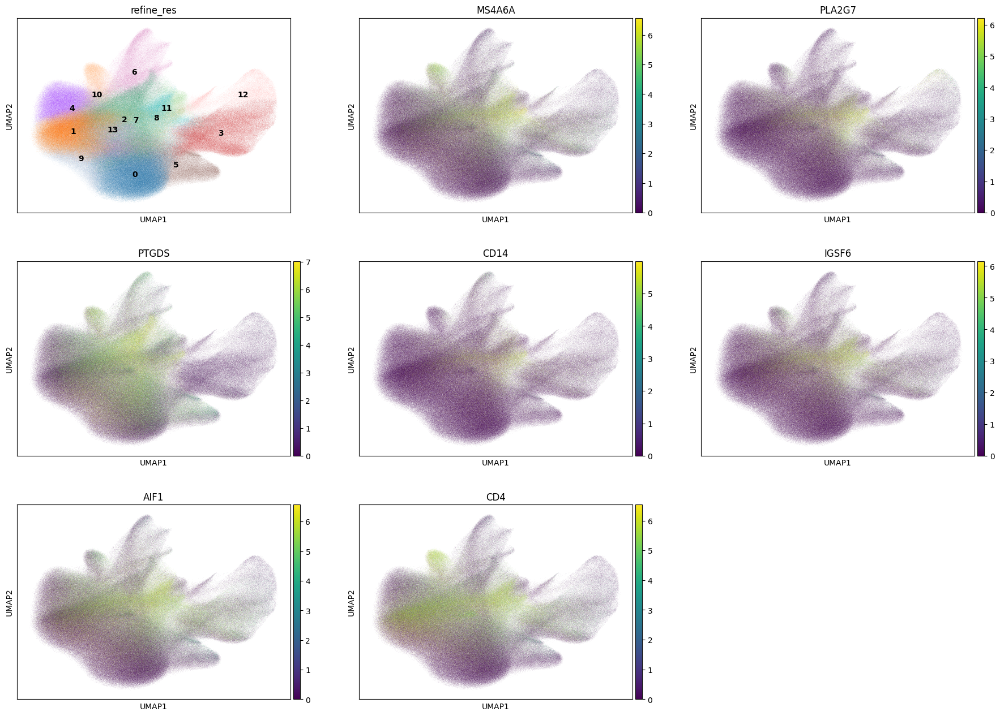

In [77]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 74448
Percentage of cells in cluster 7: 5.6


In [79]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.9. Cluster 8

In [80]:
cluster_id = '8'

In [81]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,64.8
1,B,B,normal_cell,16.2
2,T,T,normal_cell,11.0
3,NA,NA,NA,3.1
4,DC,Follicular_DC,normal_cell,1.1


In [82]:
top_ranked_genes[cluster_id]

0       FGL2
1       AIF1
2       MNDA
3    CLEC10A
4     CSF2RA
5        CD4
6     SLAMF7
Name: 8, dtype: object

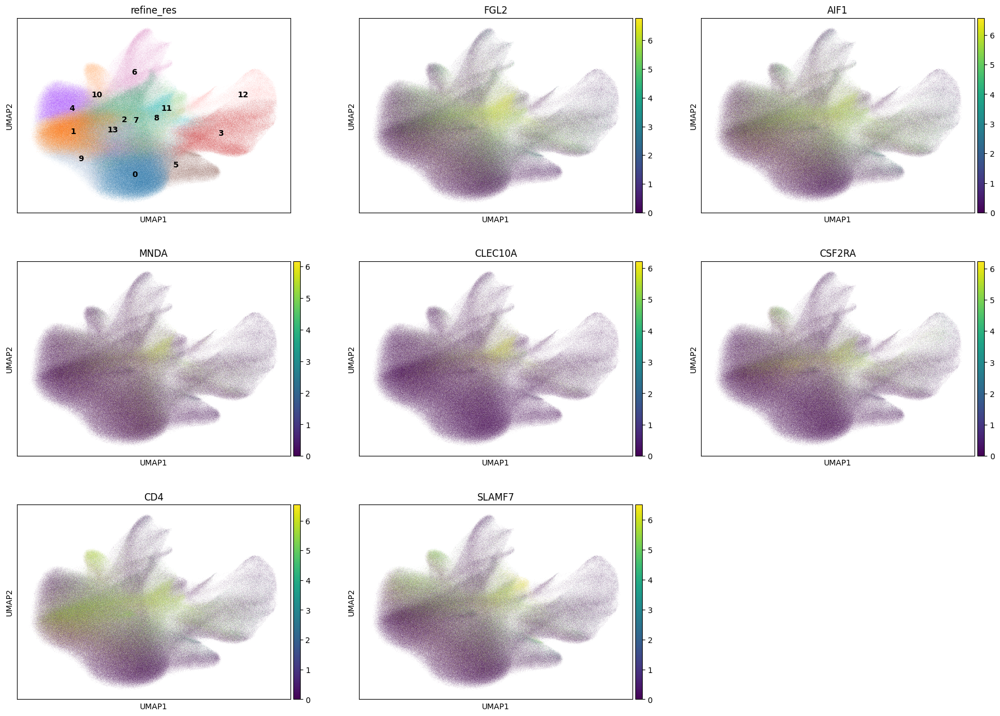

In [83]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [84]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 64617
Percentage of cells in cluster 8: 4.8


In [85]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.10. Cluster 9

In [86]:
cluster_id = '9'

In [87]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,42.9
1,NA,NA,NA,26.7
2,B,B,normal_cell,16.8
3,DC,Follicular_DC,normal_cell,6.1
4,T,T_CD8,normal_cell,4.8


In [88]:
top_ranked_genes[cluster_id]

0     TRAC
1    PTPRC
2     IL7R
3    MS4A1
4     CD3E
5     CD8A
6     CD3D
Name: 9, dtype: object

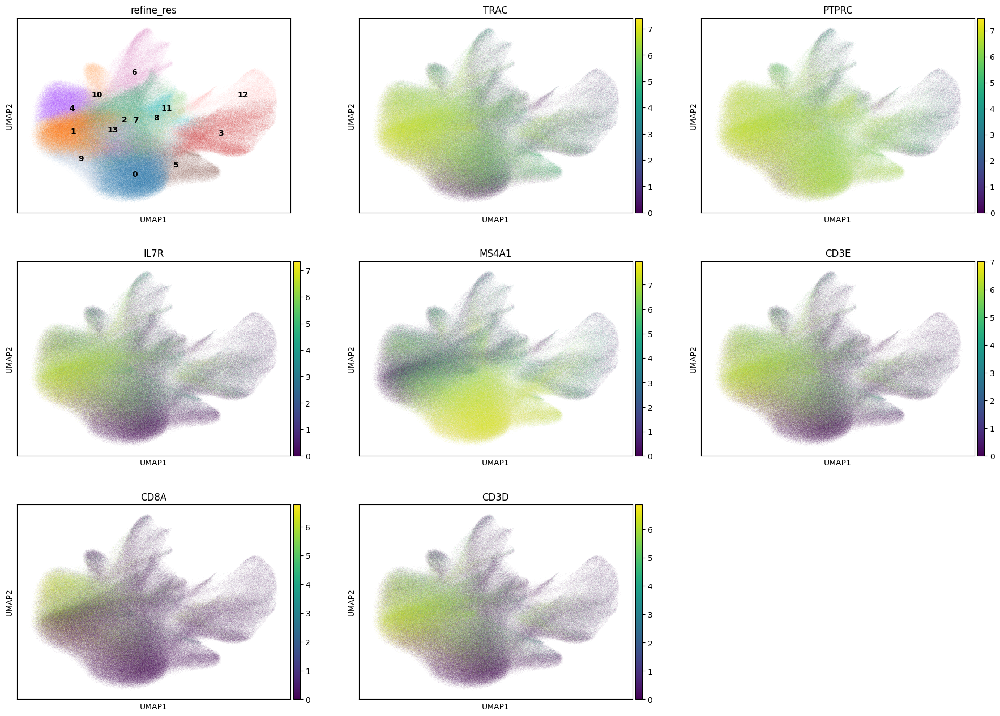

In [89]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [90]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 60662
Percentage of cells in cluster 9: 4.5


In [91]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.11. Cluster 10

In [92]:
cluster_id = '10'

In [93]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,pDC,pDC,normal_cell,50.4
1,T,T,normal_cell,21.8
2,B,B,normal_cell,14.2
3,NA,NA,NA,5.9
4,DC,Follicular_DC,normal_cell,2.8


In [94]:
top_ranked_genes[cluster_id]

0    LILRA4
1      GZMB
2      IRF8
3     MPEG1
4     IL3RA
5      PLD4
6       CD4
Name: 10, dtype: object

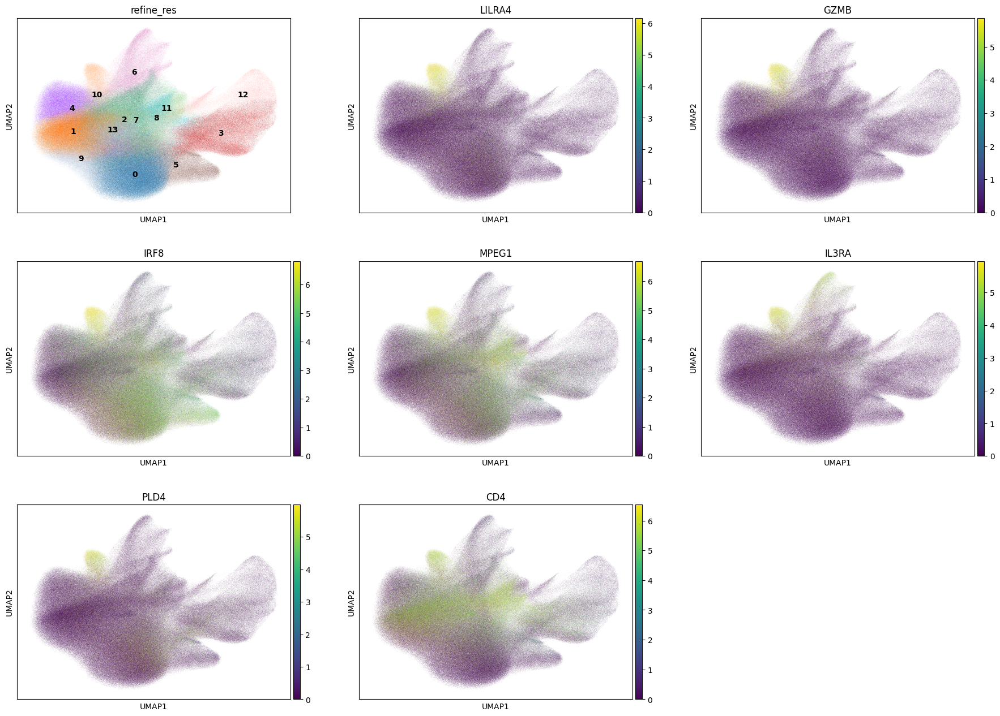

In [95]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 48667
Percentage of cells in cluster 10: 3.6


In [97]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'pDC'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'pDC'

### 5.12. Cluster 11

In [98]:
cluster_id = '11'

In [99]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,58.1
1,B,B,normal_cell,13.9
2,T,T,normal_cell,12.1
3,NA,NA,NA,5.7
4,DC,Follicular_DC,normal_cell,3.7


In [100]:
top_ranked_genes[cluster_id]

0        MZB1
1      TENT5C
2      SLAMF7
3      FKBP11
4       PRDM1
5       CD79A
6    TNFRSF17
Name: 11, dtype: object

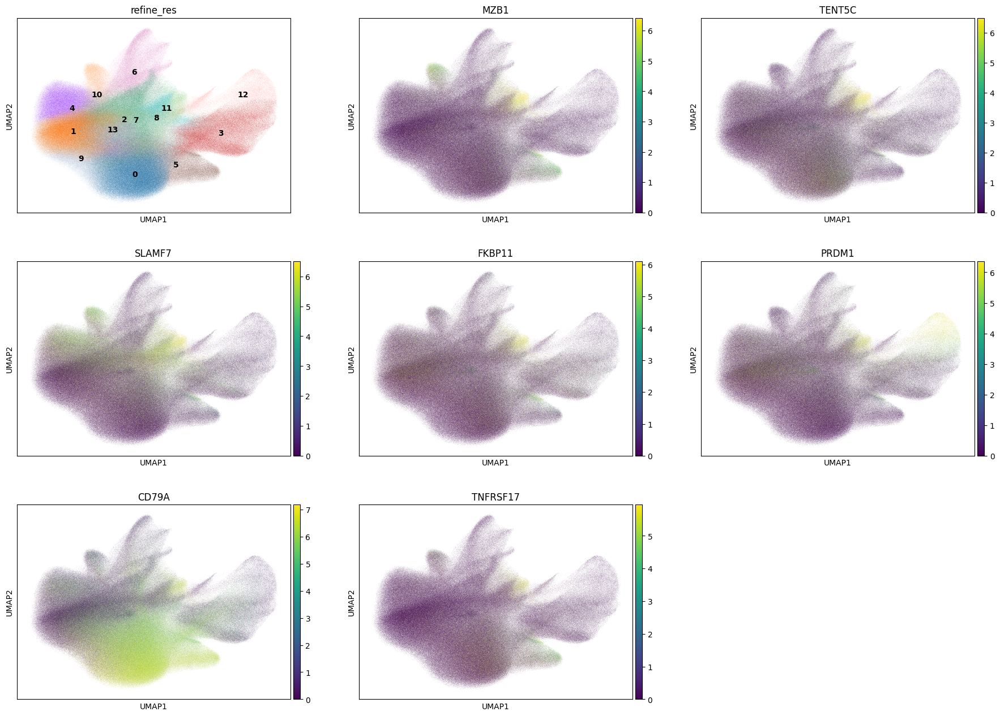

In [101]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [102]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 31013
Percentage of cells in cluster 11: 2.3


In [103]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.13. Cluster 12

In [104]:
cluster_id = '12'

In [105]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Epithelial,normal_cell,74.7
1,NA,NA,NA,17.2
2,B,B,normal_cell,3.2
3,T,T,normal_cell,2.0
4,DC,Follicular_DC,normal_cell,1.2


In [106]:
top_ranked_genes[cluster_id]

0    C15orf48
1        MALL
2         EHF
3    SERPINB2
4     ALDH1A3
5    APOBEC3A
6     S100A12
Name: 12, dtype: object

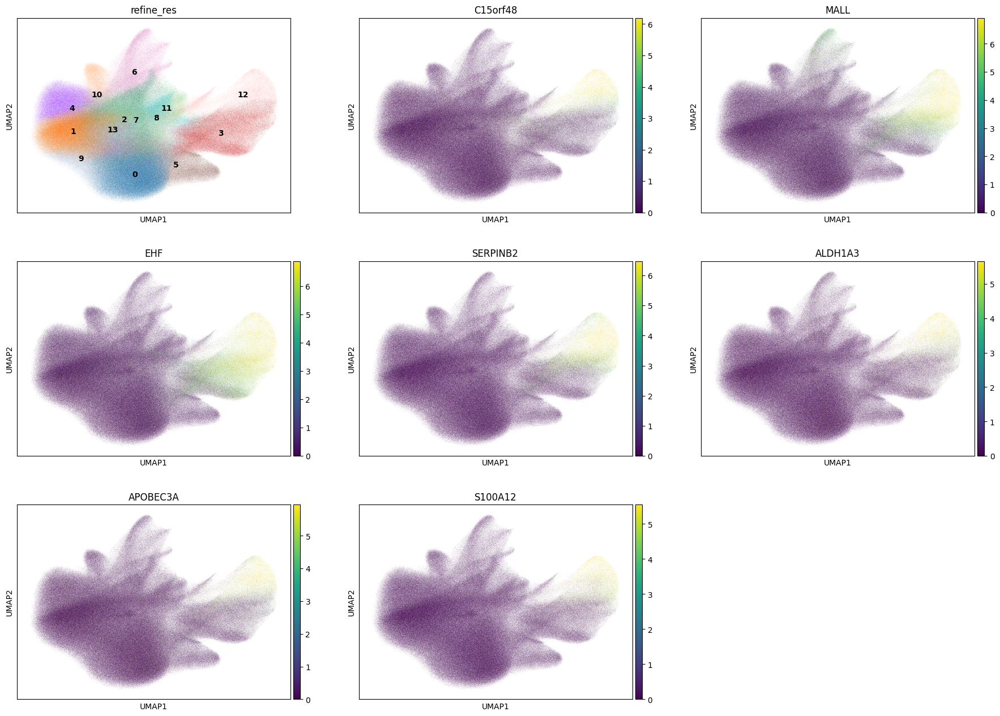

In [107]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [108]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 26040
Percentage of cells in cluster 12: 2.0


In [109]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.14. Cluster 3

In [110]:
cluster_id = '13'

In [111]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,49.6
1,T,Proliferating_Treg,normal_cell,45.5
2,DC,Follicular_DC,normal_cell,1.2
3,T,T_CD8,normal_cell,1.0
4,B,B,normal_cell,0.7


In [112]:
top_ranked_genes[cluster_id]

0    MKI67
1    CTLA4
2     CD28
3     PCNA
4      CD2
5     TRAC
6    TOP2A
Name: 13, dtype: object

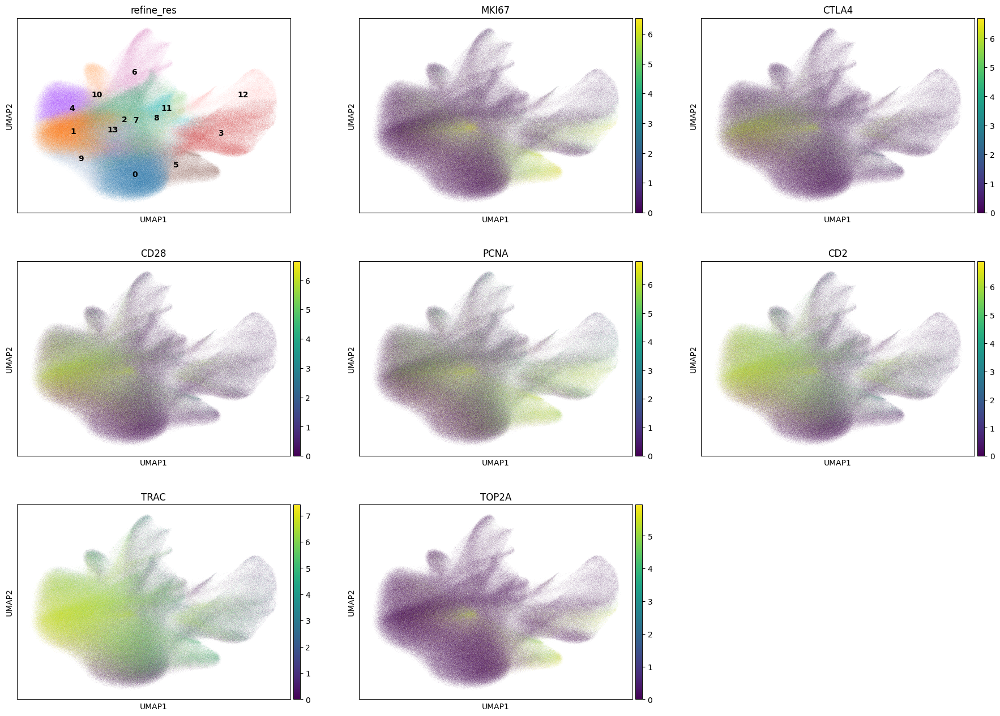

In [113]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [114]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 23237
Percentage of cells in cluster 13: 1.7


In [115]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_T_CD4'

## 6. Cancer cells

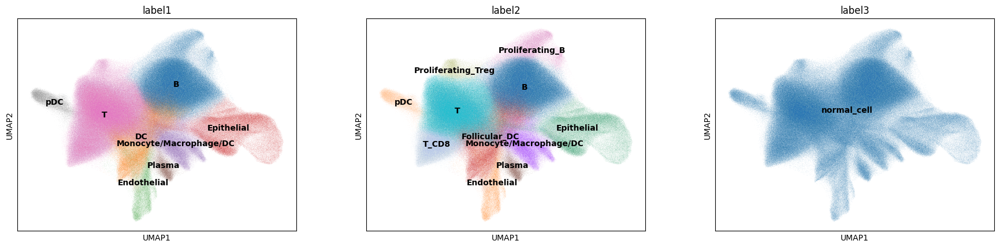

In [116]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

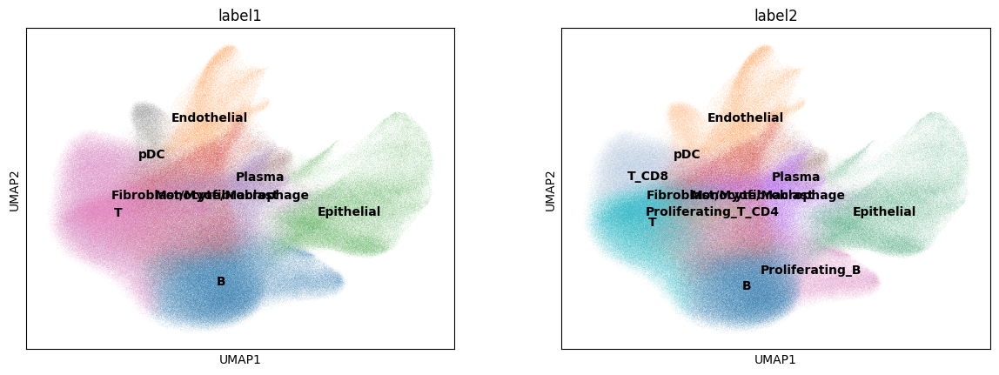

In [117]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [118]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

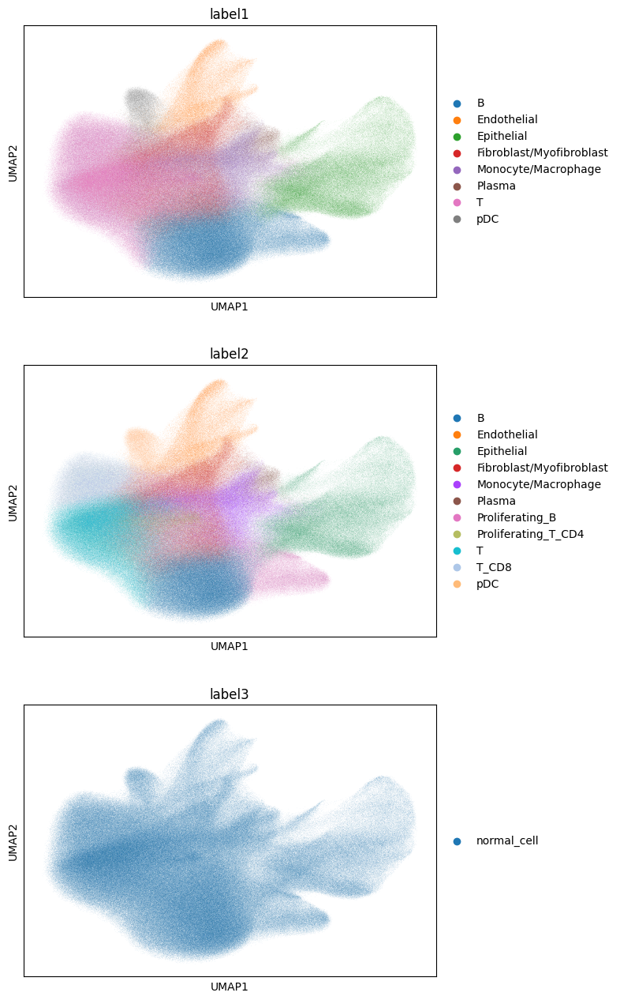

In [119]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [120]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,92,0,0,0,0,92,42.040470,27.725939,cell_labels,0,8,13,13,T,Proliferating_T_CD4,normal_cell
1,aaaaaaab-1,46,0,0,0,0,46,31.925470,8.037813,cell_labels,3,4,6,6,Endothelial,Endothelial,normal_cell
2,aaaaaaac-1,48,0,0,0,0,48,37.208751,19.823594,cell_labels,0,3,2,2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell
3,aaaaaaad-1,62,0,0,0,0,62,56.309846,13.908126,cell_labels,0,3,2,2,Fibroblast/Myofibroblast,Fibroblast/Myofibroblast,normal_cell
4,aaaaaaae-1,60,0,0,0,0,60,42.040470,13.862969,cell_labels,3,4,6,6,Endothelial,Endothelial,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1349615,aabejhop-1,213,0,0,0,0,213,278.930166,21.991095,cell_labels,2,2,3,3,Epithelial,Epithelial,normal_cell
1349616,aabejhpa-1,178,0,0,0,0,178,76.178597,38.744064,cell_labels,2,2,12,12,Epithelial,Epithelial,normal_cell
1349617,aabejhpb-1,251,0,0,0,0,251,235.309227,54.819689,cell_labels,2,2,12,12,Epithelial,Epithelial,normal_cell
1349618,aabejhpc-1,13,0,0,0,0,13,853.904718,8.624844,cell_labels,0,1,9,9,T,T,normal_cell


In [121]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")